In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model 
from tensorflow.keras import layers 
from tensorflow.keras.optimizers import Adam 
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

In [2]:
base_dir = '/kaggle/input/anime-faces/data'

In [3]:
image_paths = []
for image_name in os.listdir(base_dir):
    image_path = os.path.join(base_dir, image_name)
    image_paths.append(image_path)

In [4]:
len(image_paths)

21552

In [5]:
image_paths.remove('/kaggle/input/anime-faces/data/data')

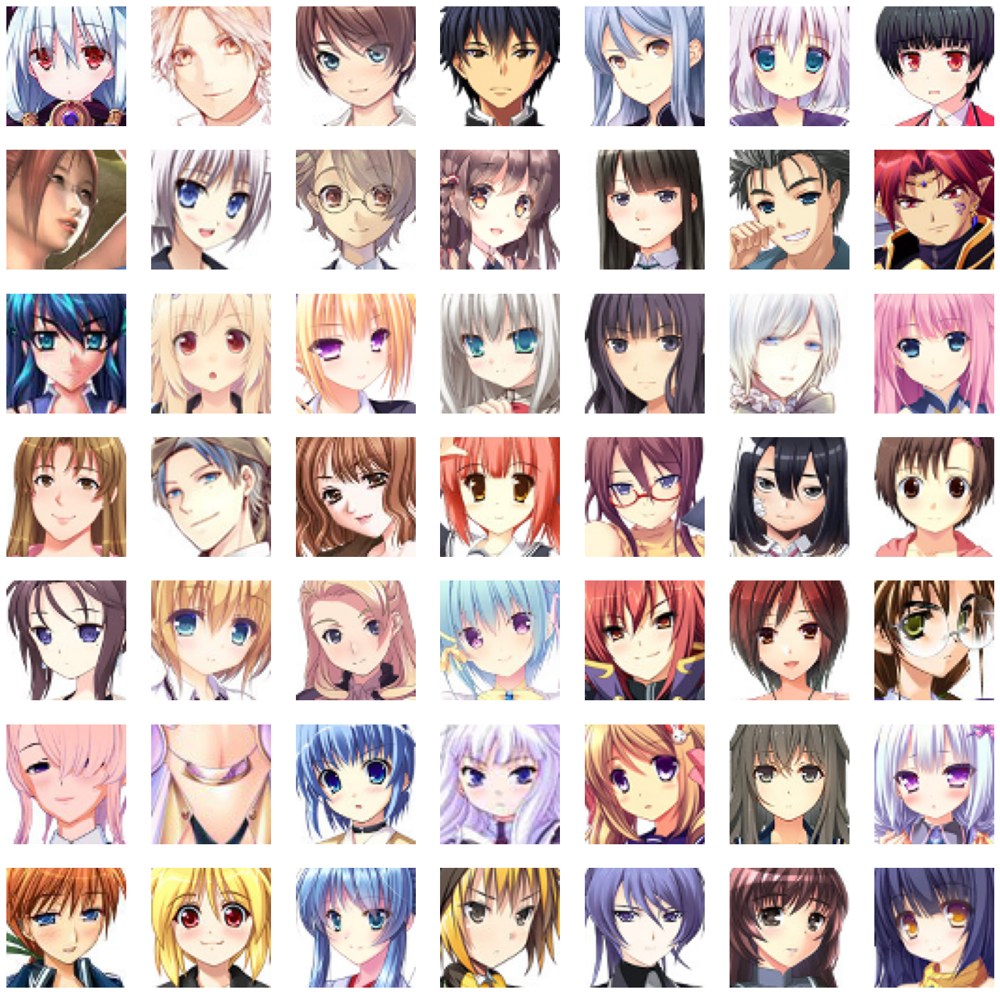

In [6]:
# to display grid of images (7x7)
plt.figure(figsize= (20, 20))
temp_images = image_paths[:49]
index = 1
for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img (image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the
    index += 1    

In [7]:
# load the image and convert to numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [8]:
train_images[0].shape

(64, 64, 3)

In [9]:
# reshape the array
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In [10]:
# normalize the images
train_images = (train_images - 127.5) / 127.5

In [11]:
train_images[0]

array([[[-0.7254902 , -0.90588236, -0.7176471 ],
        [-0.70980394, -0.88235295, -0.6862745 ],
        [-0.7019608 , -1.        , -0.7176471 ],
        ...,
        [-0.09019608,  0.01176471,  0.3882353 ],
        [-0.19215687,  0.05882353,  0.4509804 ],
        [-0.34117648, -0.13725491,  0.29411766]],

       [[-0.7254902 , -0.90588236, -0.7176471 ],
        [-0.73333335, -0.8666667 , -0.7019608 ],
        [-0.52156866, -0.8666667 , -0.5686275 ],
        ...,
        [-0.29411766,  0.01176471,  0.3019608 ],
        [-0.08235294,  0.15294118,  0.5294118 ],
        [-0.23921569,  0.09019608,  0.45882353]],

       [[-0.7019608 , -0.8901961 , -0.7019608 ],
        [-0.7176471 , -0.8745098 , -0.69411767],
        [-0.5686275 , -0.8509804 , -0.58431375],
        ...,
        [-0.22352941,  0.1764706 ,  0.48235294],
        [-0.13725491,  0.1764706 ,  0.4745098 ],
        [-0.06666667,  0.24705882,  0.5058824 ]],

       ...,

       [[-0.30980393, -0.6862745 , -0.29411766],
        [-0

Create Generator & Discriminator Models

In [12]:
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

generator model

In [13]:
model = Sequential (name='generator')
# 1d random noise
model.add(layers. Dense(8 * 8 * 512, input_dim=LATENT_DIM))
# model.add(layers.BatchNormalization()) 
model.add(layers.ReLU())
                    
# convert id to 3d
model.add(layers.Reshape((8, 8, 512)))
                    
# upsample to 16x16
model.add(layers.Conv2DTranspose (256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())
                    
# upsamole to 32×32
model.add(layers.Conv2DTranspose (128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT)) 
model.add(layers.ReLU())
                                  
# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT)) 
model.add(layers. ReLU())
                                  
model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()                    

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 32768)             3309568   
                                                                 
 re_lu (ReLU)                (None, 32768)             0         
                                                                 
 reshape (Reshape)           (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 16, 16, 256)      2097408   
 nspose)                                                         
                                                                 
 re_lu_1 (ReLU)              (None, 16, 16, 256)       0         
                                                                 
 conv2d_transpose_1 (Conv2DT  (None, 32, 32, 128)      524416    
 ranspose)                                               

Discriminator Model

In [14]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization ())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization()) 
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization()) 
model.add(layers.LeakyReLU( alpha=alpha))

model.add(layers.Flatten ())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid')) 

discriminator = model
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization (BatchN  (None, 32, 32, 64)       256       
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 64)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_1 (Batc  (None, 16, 16, 128)      512       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 128)     

create DCGAN

In [15]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')
    
    @property 
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn
    
    def train_step(self, real_images) :
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))
        
        
        # train the discriminator with real (1) and fake (9) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            real_labels #= 0.05 * tf.random.uniform(tf. shape (real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)
            
            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)
            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2
            
        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))


        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)
            
        # comoute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))
        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
        
        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [16]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100) :
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])
    def on_epoch_end(self, epoch, logs=None) :
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()
                                        
        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs) :
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis ('off')
        # pit. savefig('epoch_(:93d) .png' . format (epoch))
        plt.show()
        
    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [17]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [18]:
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/50
674/674 [==============================] - ETA: 0s - d_loss: 0.7677 - g_loss: 2.6030

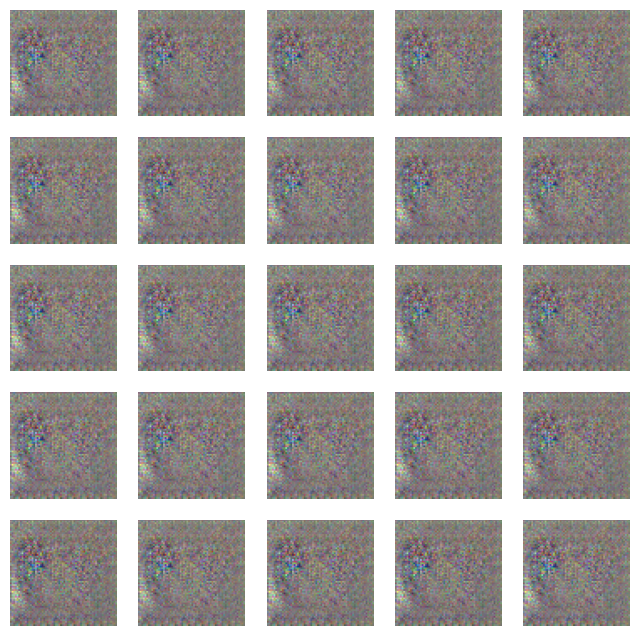

674/674 [==============================] - 58s 67ms/step - d_loss: 0.7677 - g_loss: 2.6030
Epoch 2/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6192 - g_loss: 1.7462

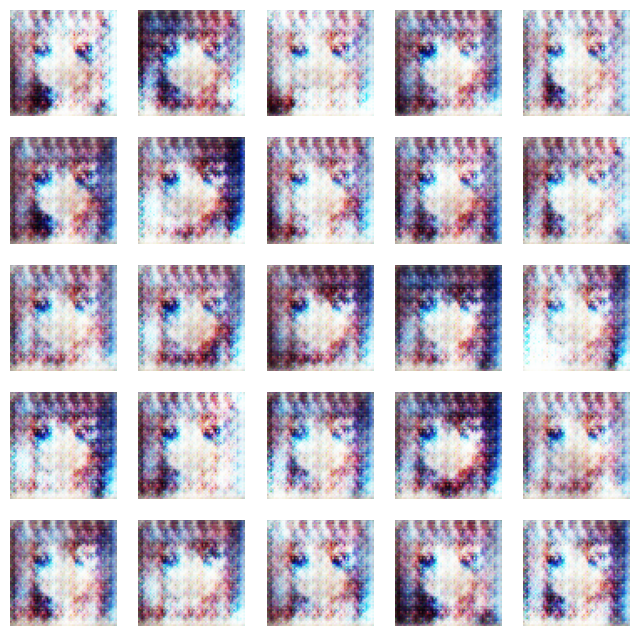

674/674 [==============================] - 46s 69ms/step - d_loss: 0.6193 - g_loss: 1.7458
Epoch 3/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6242 - g_loss: 1.5489

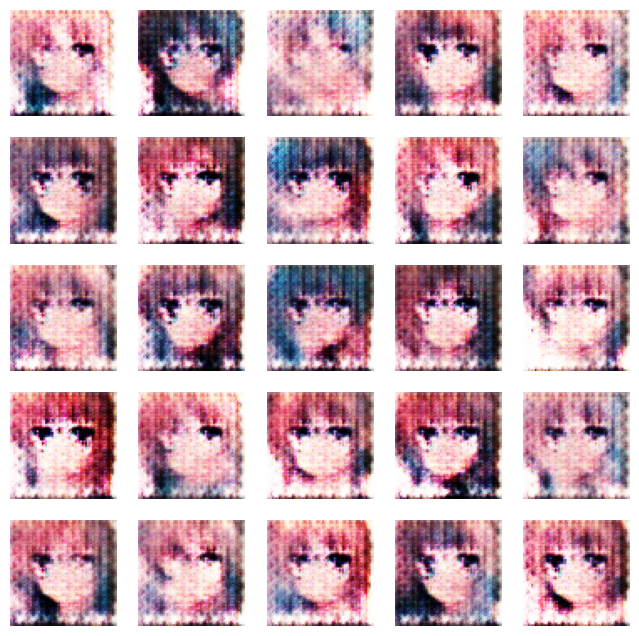

674/674 [==============================] - 47s 70ms/step - d_loss: 0.6247 - g_loss: 1.5494
Epoch 4/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6176 - g_loss: 1.6381

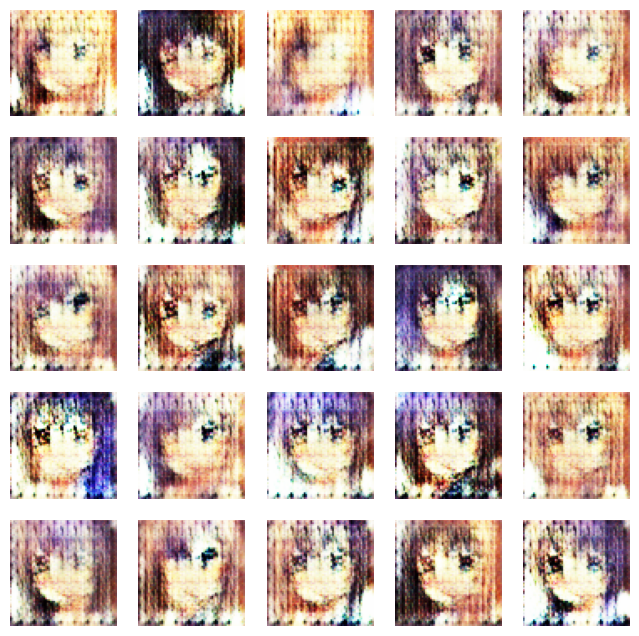

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6178 - g_loss: 1.6378
Epoch 5/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6113 - g_loss: 1.5812

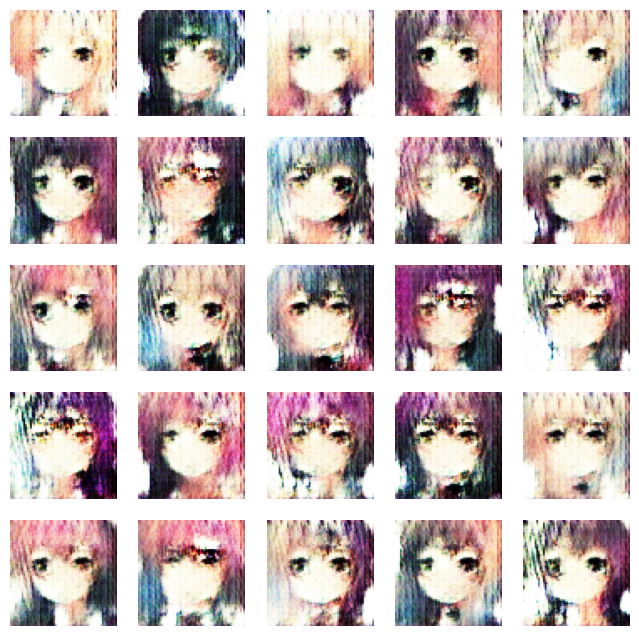

674/674 [==============================] - 48s 72ms/step - d_loss: 0.6114 - g_loss: 1.5813
Epoch 6/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6041 - g_loss: 1.6384

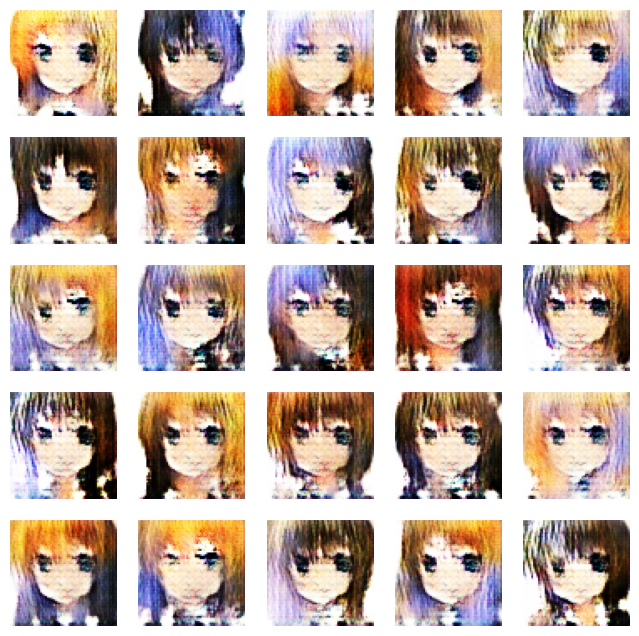

674/674 [==============================] - 50s 74ms/step - d_loss: 0.6041 - g_loss: 1.6377
Epoch 7/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6056 - g_loss: 1.5446

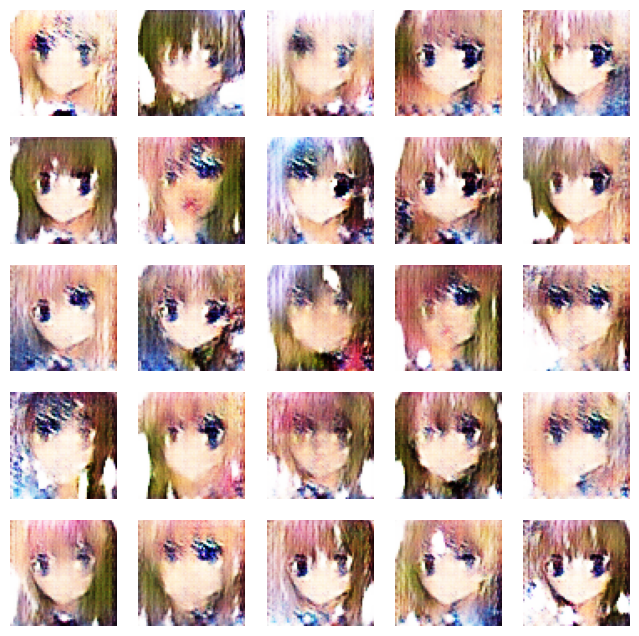

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6058 - g_loss: 1.5443
Epoch 8/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5740 - g_loss: 1.5540

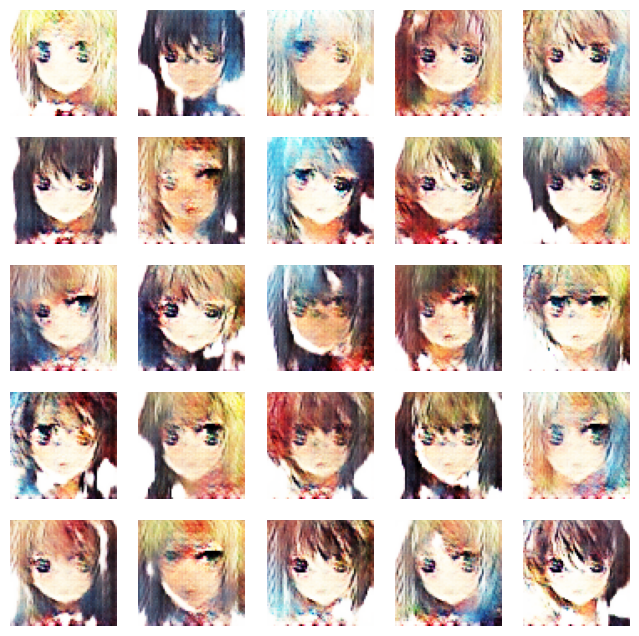

674/674 [==============================] - 49s 73ms/step - d_loss: 0.5739 - g_loss: 1.5542
Epoch 9/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6103 - g_loss: 1.3714

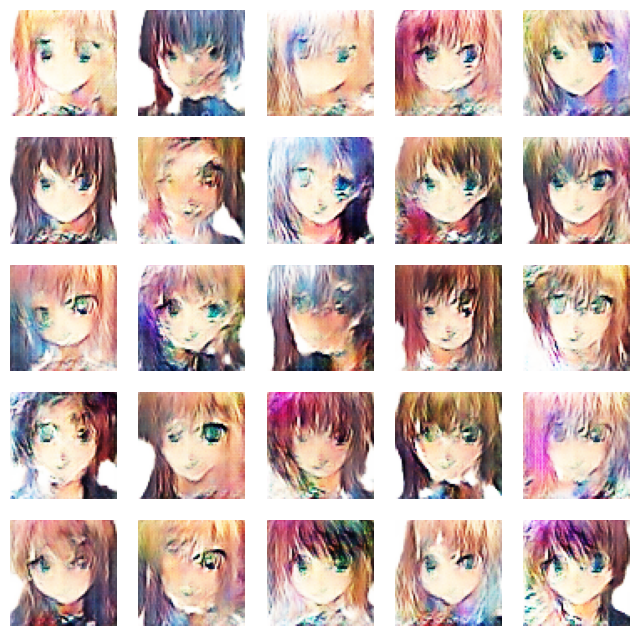

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6104 - g_loss: 1.3711
Epoch 10/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6672 - g_loss: 1.1656

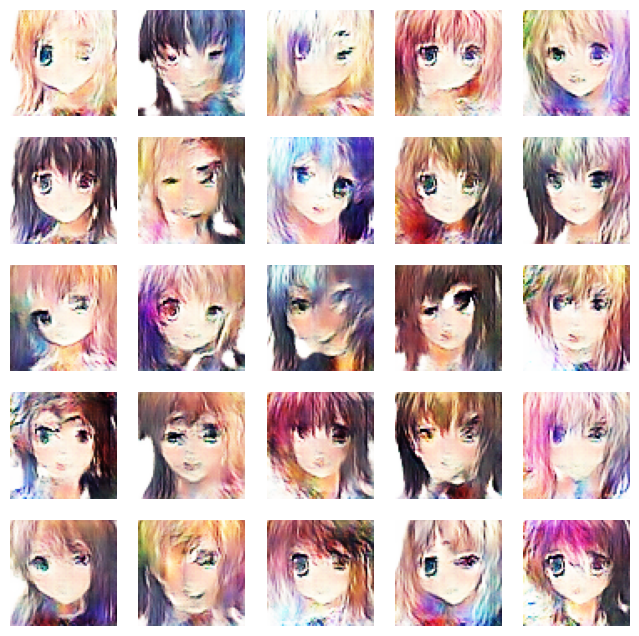

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6673 - g_loss: 1.1661
Epoch 11/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6864 - g_loss: 1.0427

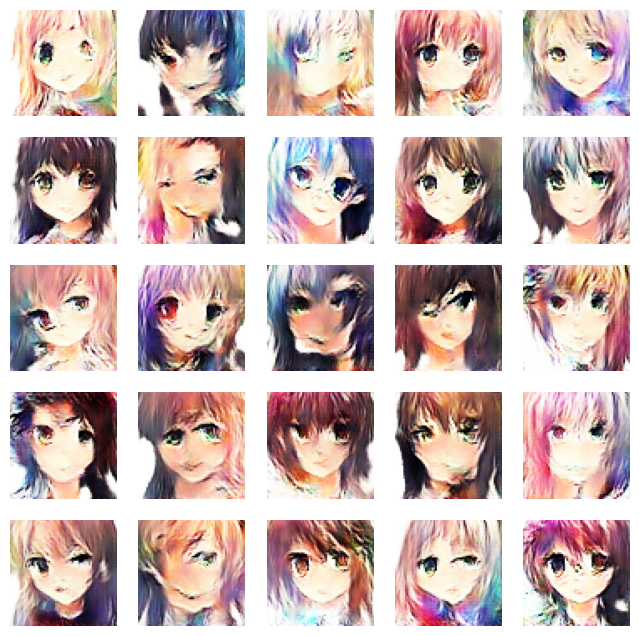

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6863 - g_loss: 1.0430
Epoch 12/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6845 - g_loss: 1.0014

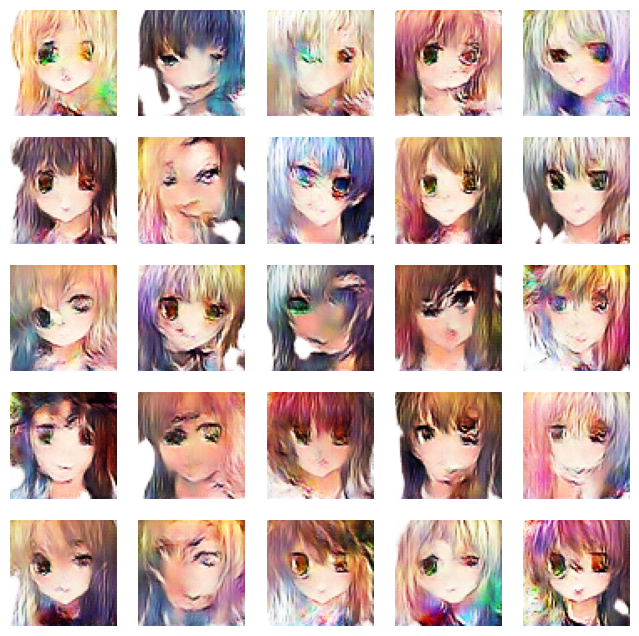

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6846 - g_loss: 1.0015
Epoch 13/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6817 - g_loss: 0.9826

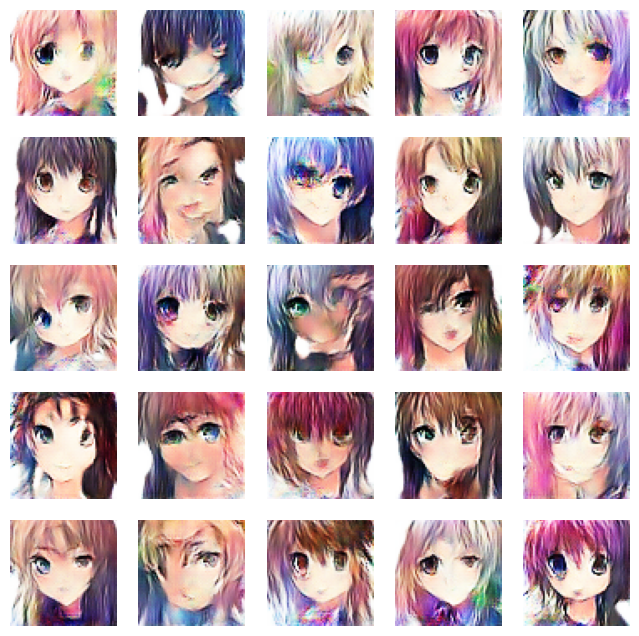

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6815 - g_loss: 0.9826
Epoch 14/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6864 - g_loss: 0.9559

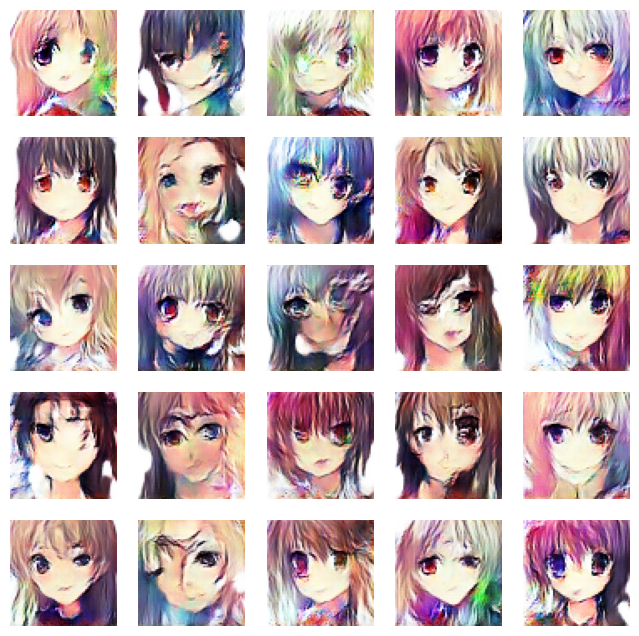

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6864 - g_loss: 0.9562
Epoch 15/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6877 - g_loss: 0.9336

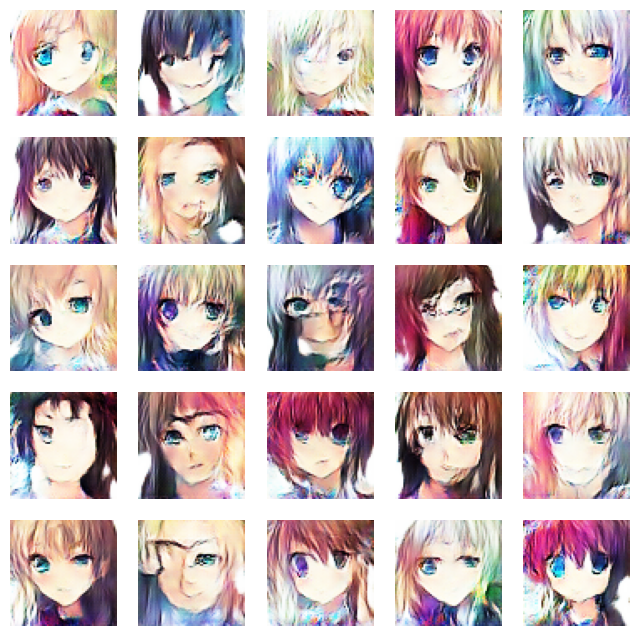

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6876 - g_loss: 0.9339
Epoch 16/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6932 - g_loss: 0.9120

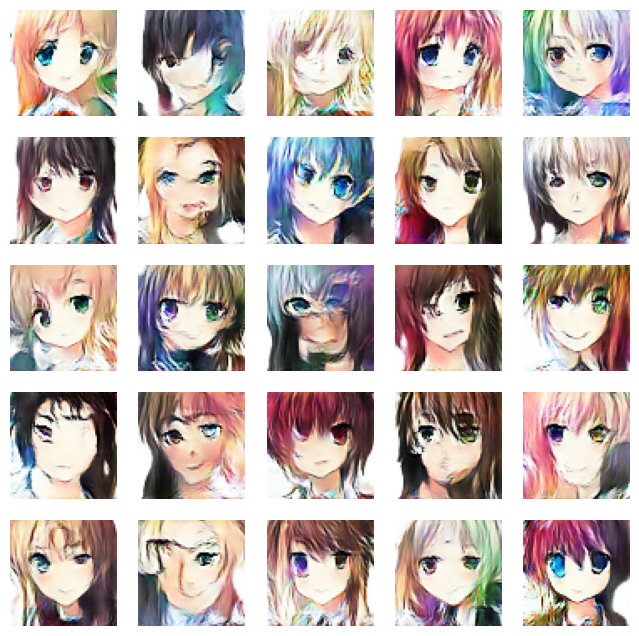

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6932 - g_loss: 0.9121
Epoch 17/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6925 - g_loss: 0.8892

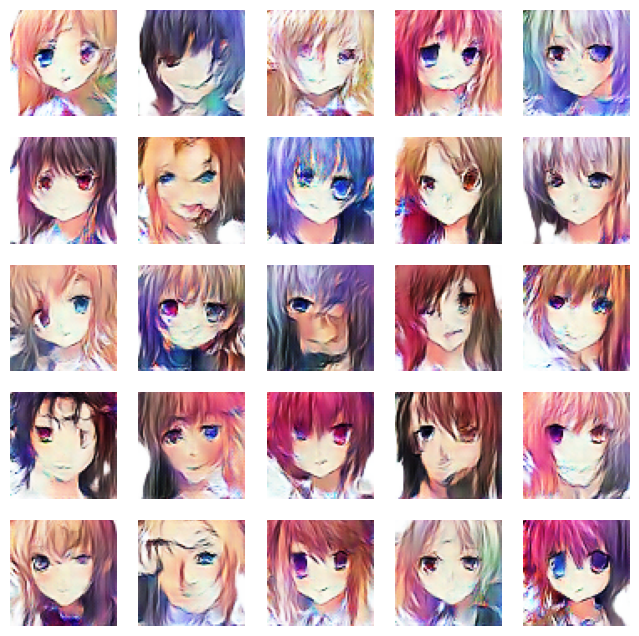

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6923 - g_loss: 0.8894
Epoch 18/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6913 - g_loss: 0.8767

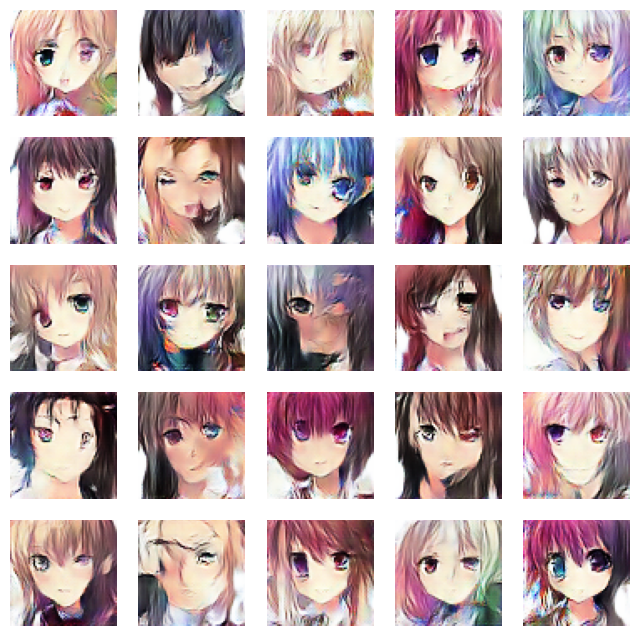

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6913 - g_loss: 0.8766
Epoch 19/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6951 - g_loss: 0.8626

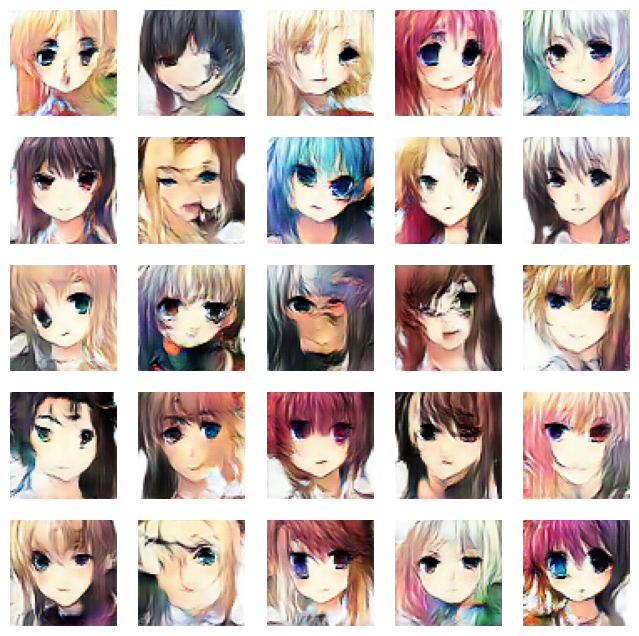

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6951 - g_loss: 0.8626
Epoch 20/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6923 - g_loss: 0.8567

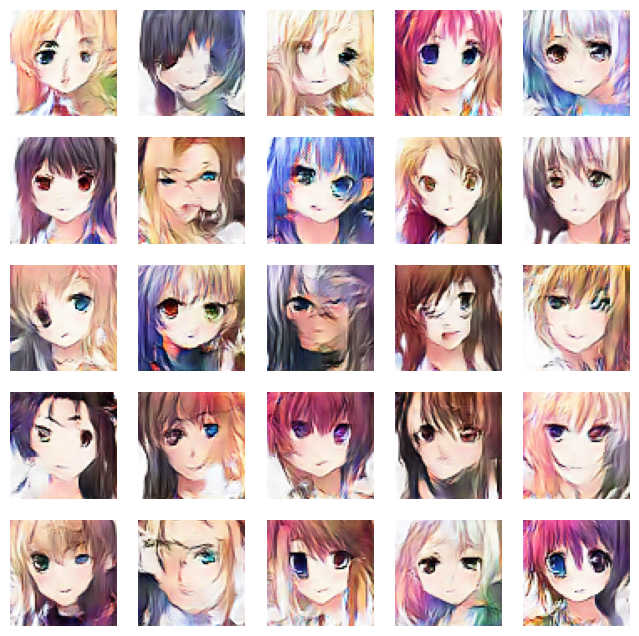

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6924 - g_loss: 0.8566
Epoch 21/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6901 - g_loss: 0.8543

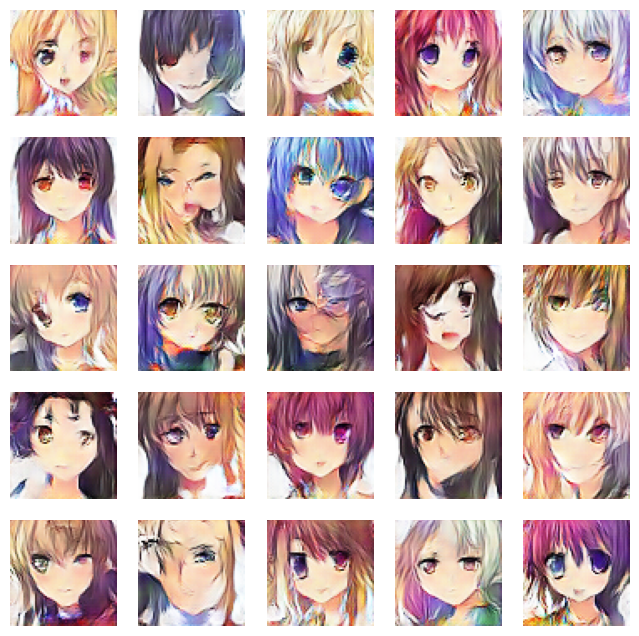

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6900 - g_loss: 0.8544
Epoch 22/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6914 - g_loss: 0.8525

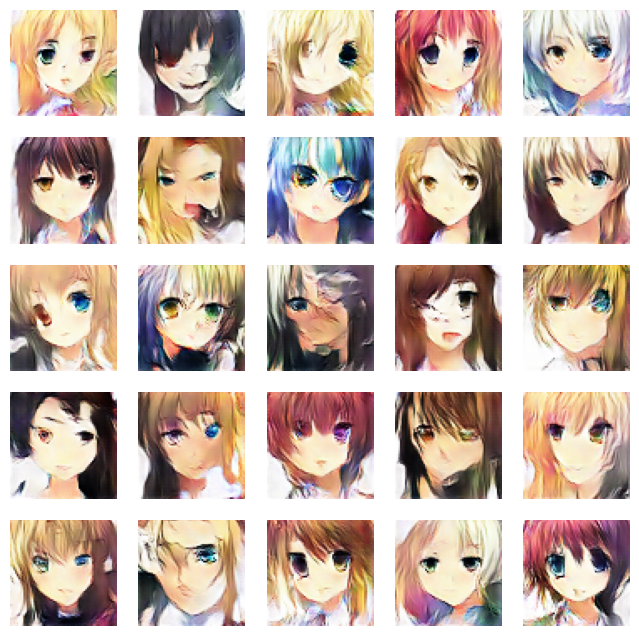

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6914 - g_loss: 0.8527
Epoch 23/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6857 - g_loss: 0.8469

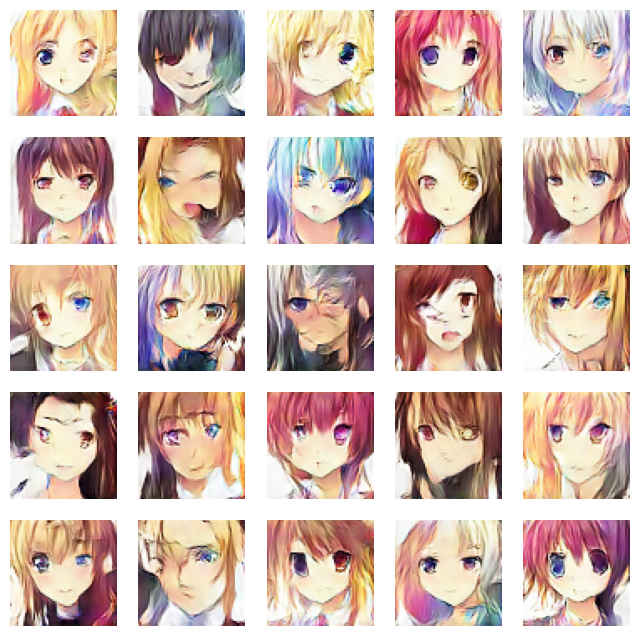

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6858 - g_loss: 0.8469
Epoch 24/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6861 - g_loss: 0.8504

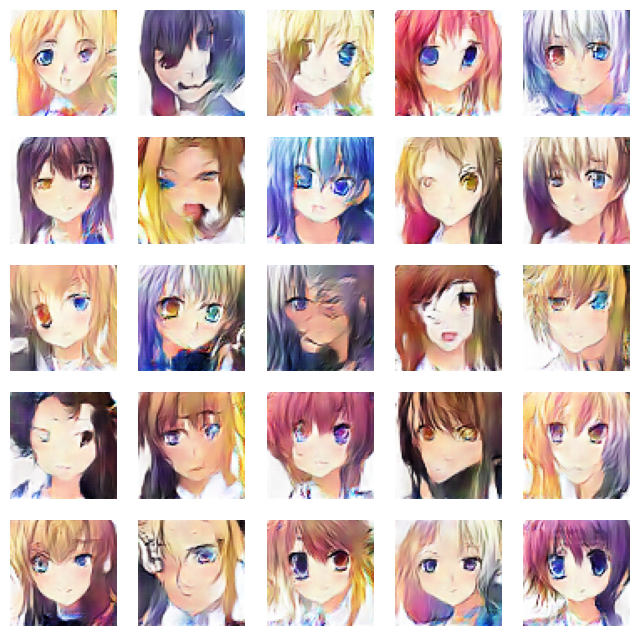

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6861 - g_loss: 0.8504
Epoch 25/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6818 - g_loss: 0.8529

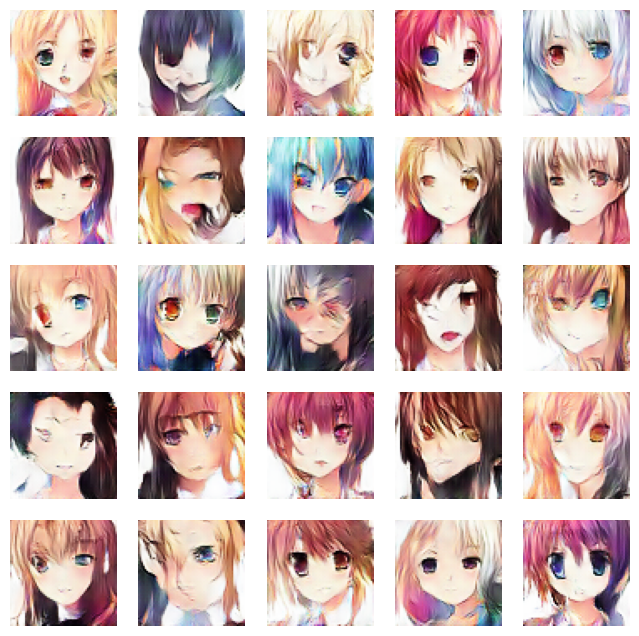

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6818 - g_loss: 0.8531
Epoch 26/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6826 - g_loss: 0.8534

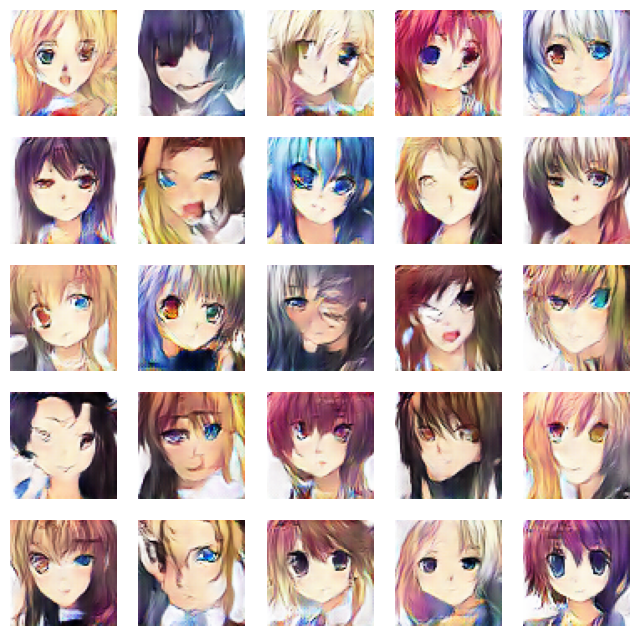

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6827 - g_loss: 0.8534
Epoch 27/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6783 - g_loss: 0.8595

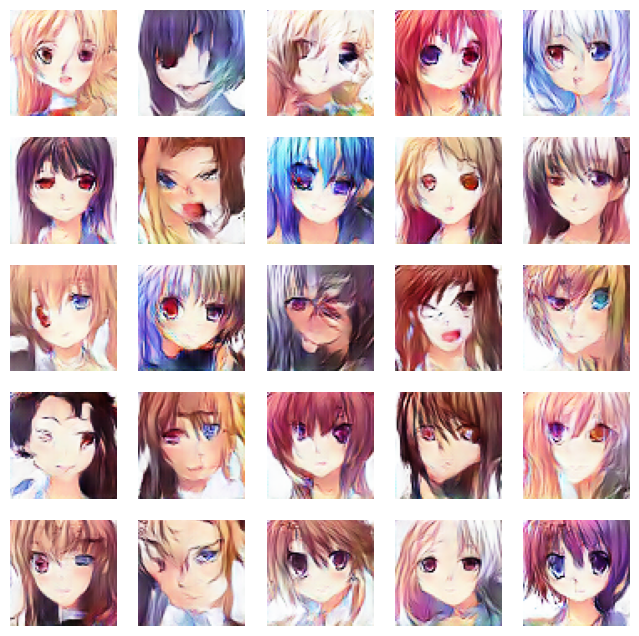

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6784 - g_loss: 0.8596
Epoch 28/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6775 - g_loss: 0.8639

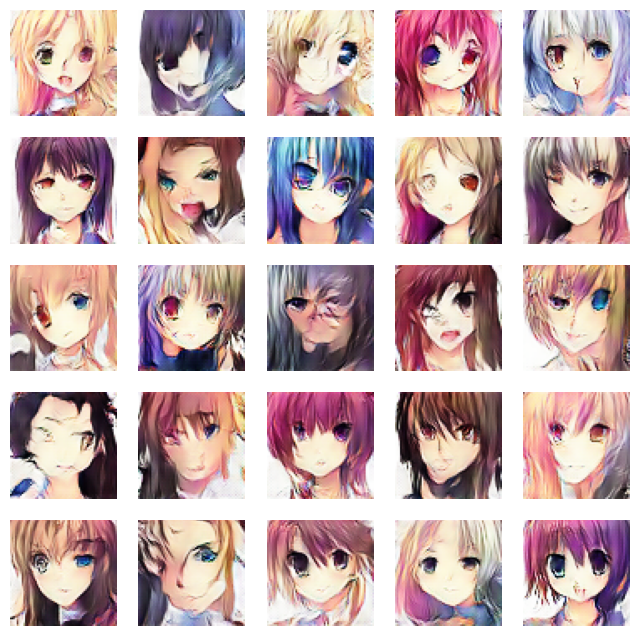

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6775 - g_loss: 0.8642
Epoch 29/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6726 - g_loss: 0.8678

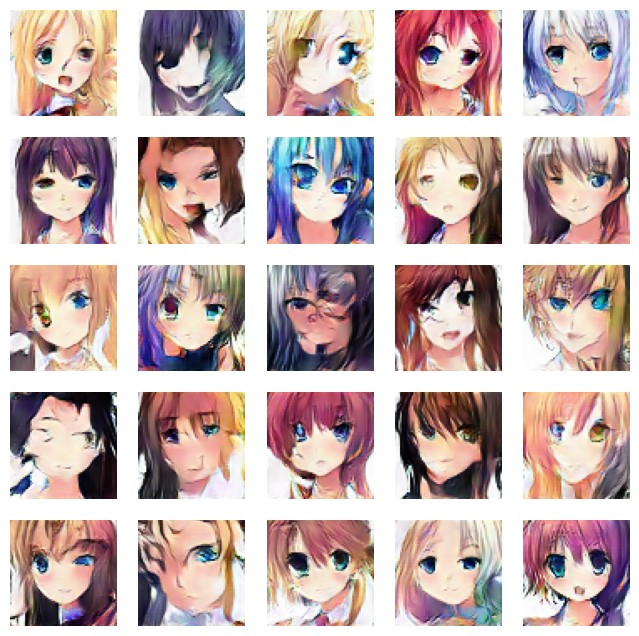

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6727 - g_loss: 0.8678
Epoch 30/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6709 - g_loss: 0.8790

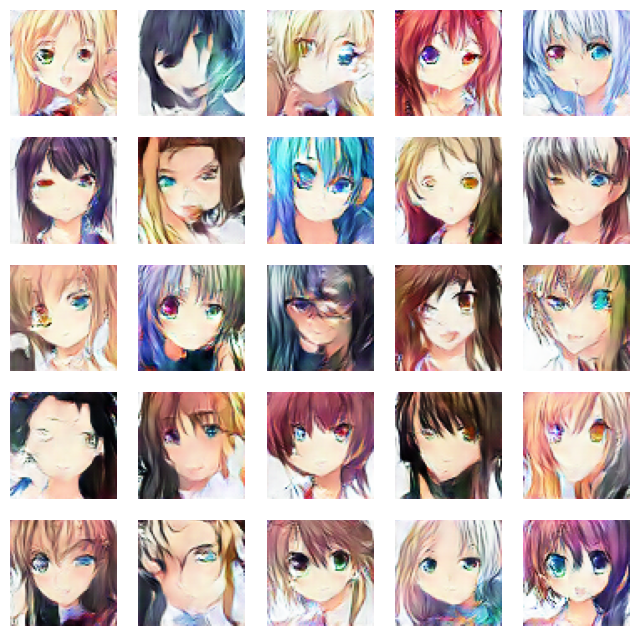

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6709 - g_loss: 0.8794
Epoch 31/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6661 - g_loss: 0.8833

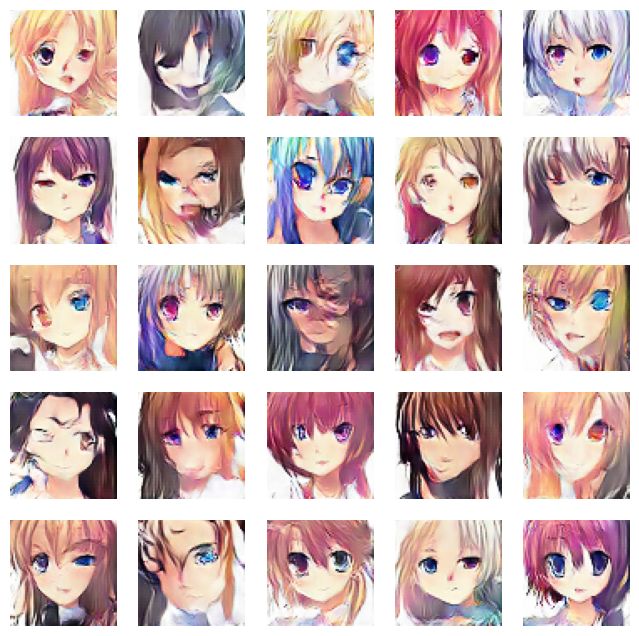

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6661 - g_loss: 0.8834
Epoch 32/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6647 - g_loss: 0.8866

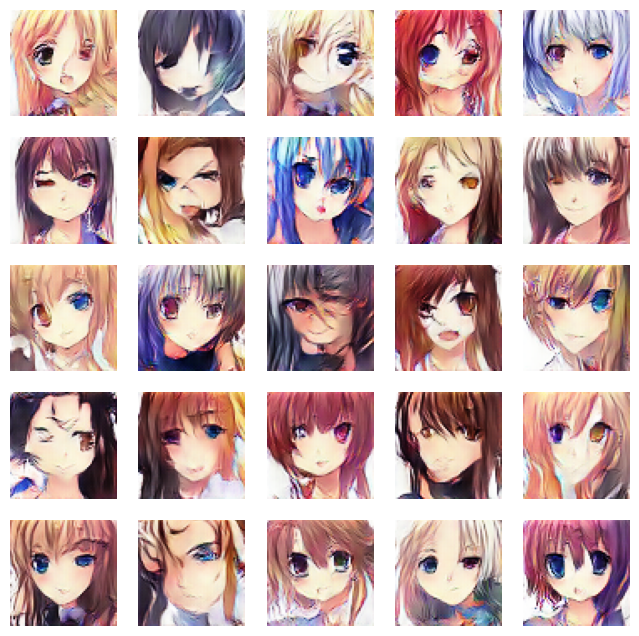

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6647 - g_loss: 0.8866
Epoch 33/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6633 - g_loss: 0.8982

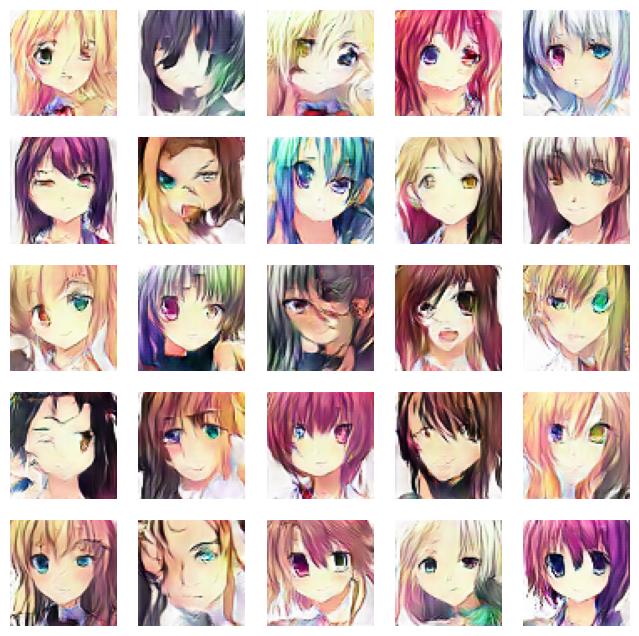

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6634 - g_loss: 0.8983
Epoch 34/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6567 - g_loss: 0.9097

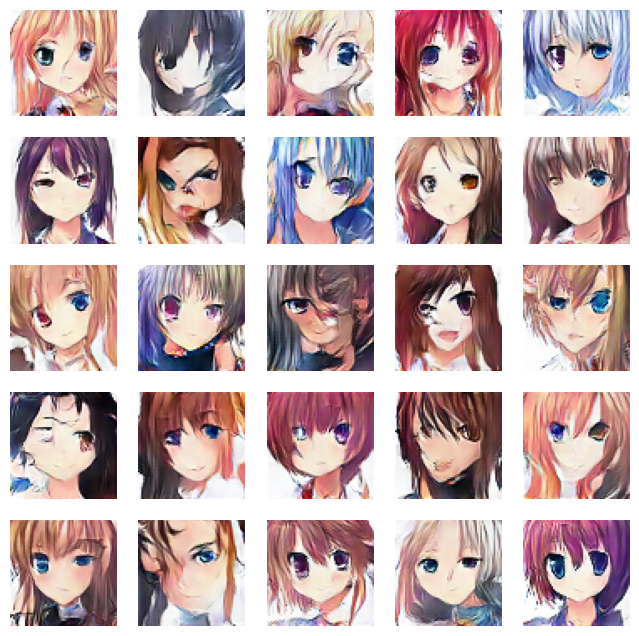

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6566 - g_loss: 0.9098
Epoch 35/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6573 - g_loss: 0.9159

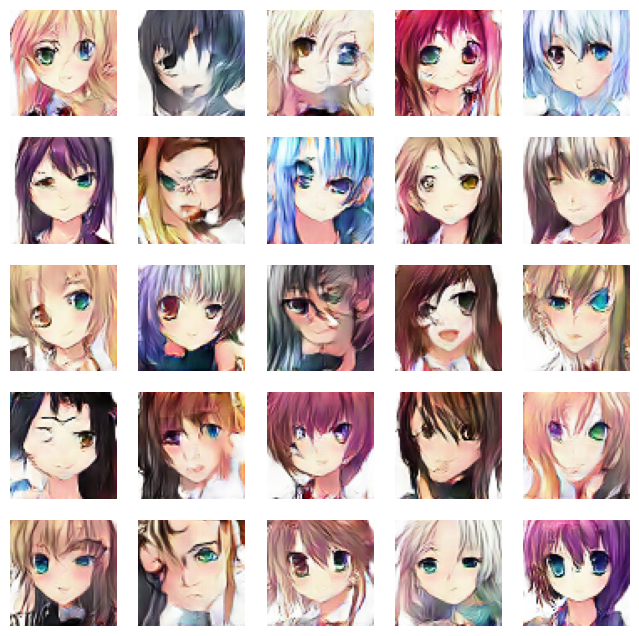

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6575 - g_loss: 0.9159
Epoch 36/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6521 - g_loss: 0.9313

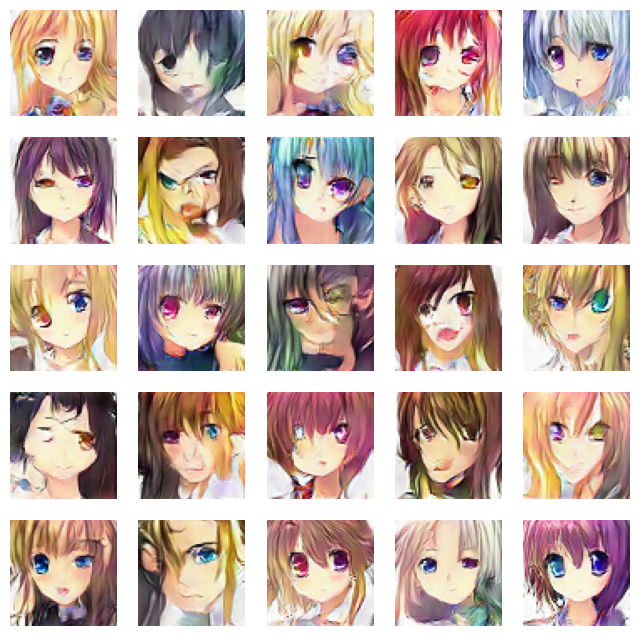

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6524 - g_loss: 0.9311
Epoch 37/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6492 - g_loss: 0.9310

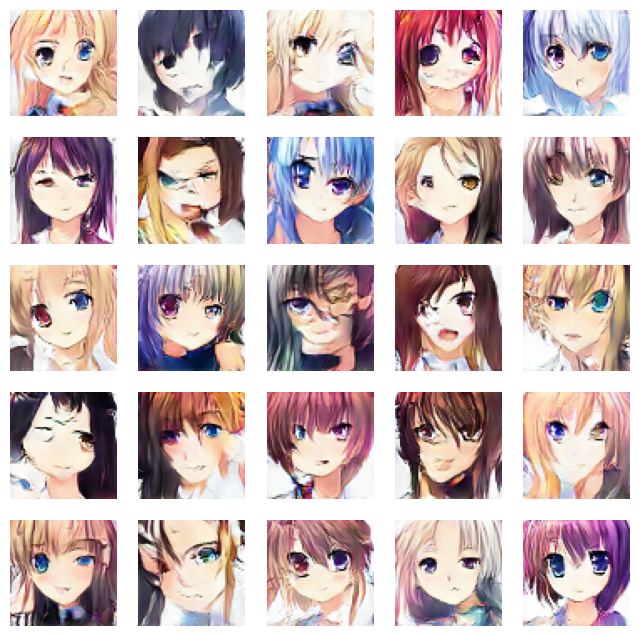

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6493 - g_loss: 0.9310
Epoch 38/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6444 - g_loss: 0.9453

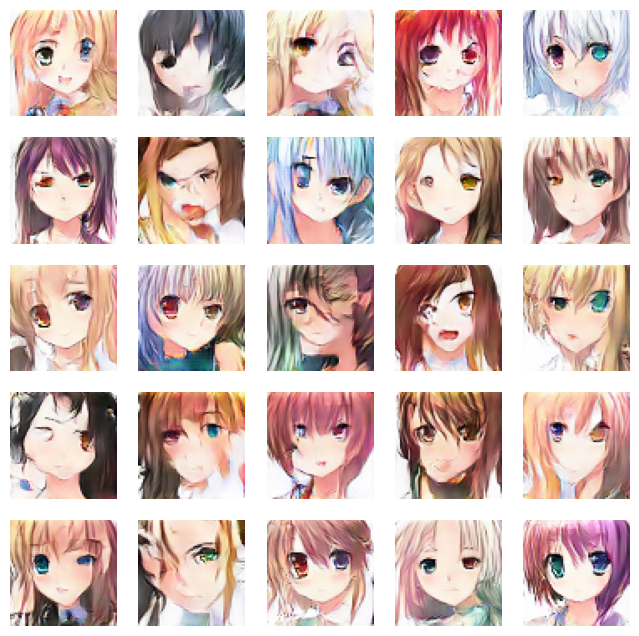

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6445 - g_loss: 0.9456
Epoch 39/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6423 - g_loss: 0.9578

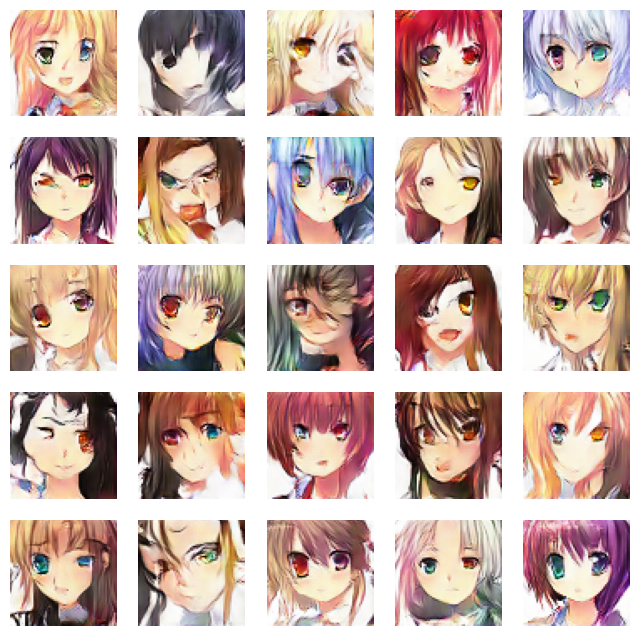

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6424 - g_loss: 0.9578
Epoch 40/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6371 - g_loss: 0.9695

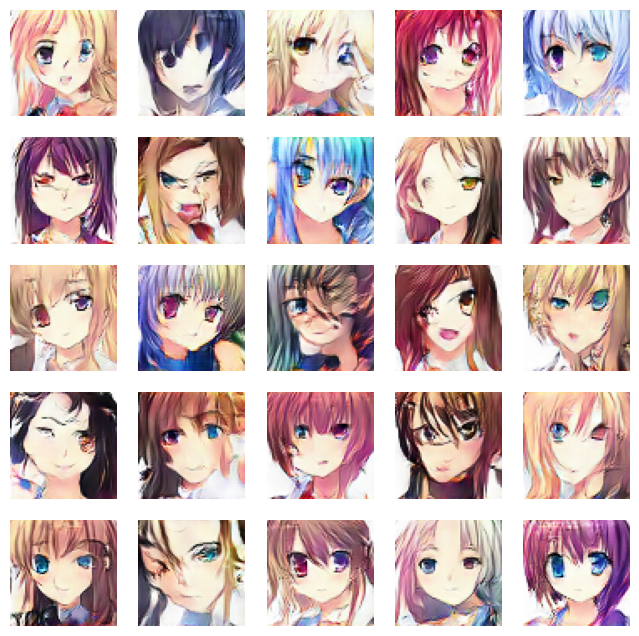

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6370 - g_loss: 0.9697
Epoch 41/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6350 - g_loss: 0.9757

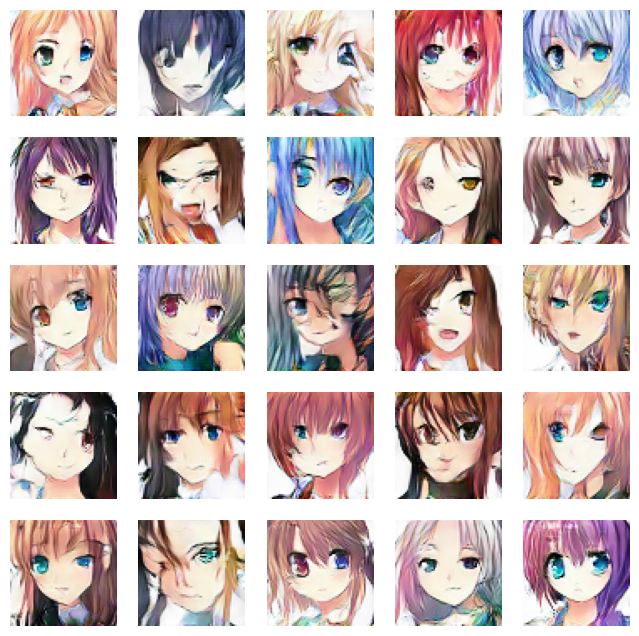

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6351 - g_loss: 0.9760
Epoch 42/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6307 - g_loss: 0.9962

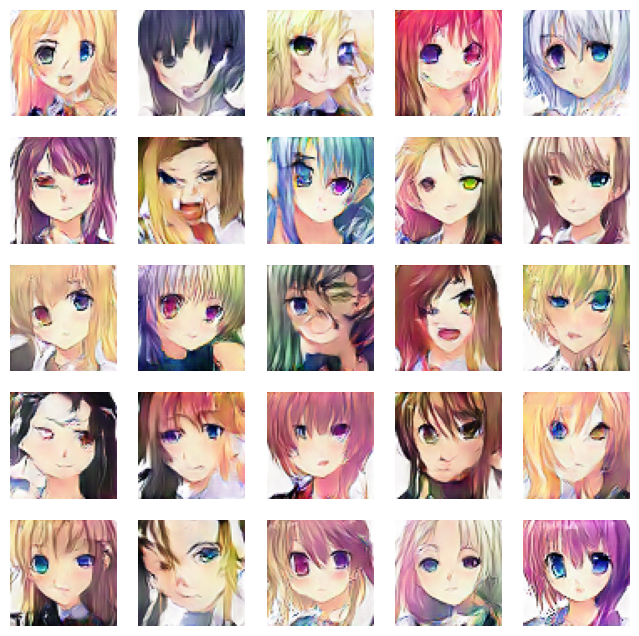

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6308 - g_loss: 0.9961
Epoch 43/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6270 - g_loss: 1.0029

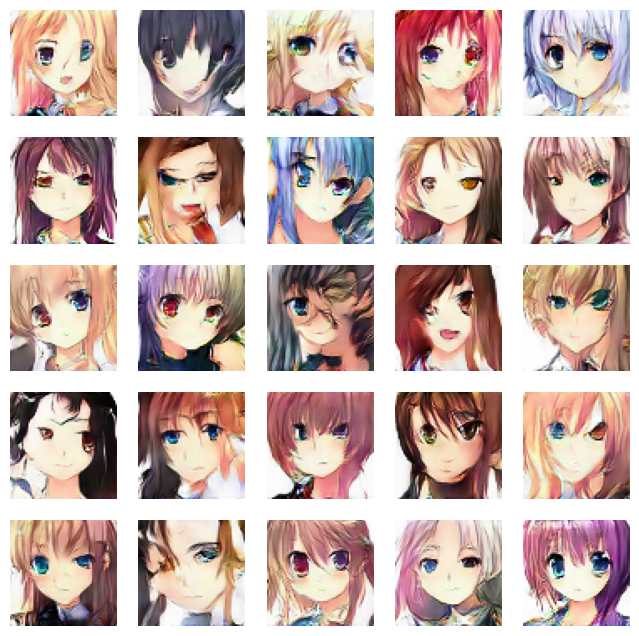

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6272 - g_loss: 1.0029
Epoch 44/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6219 - g_loss: 1.0192

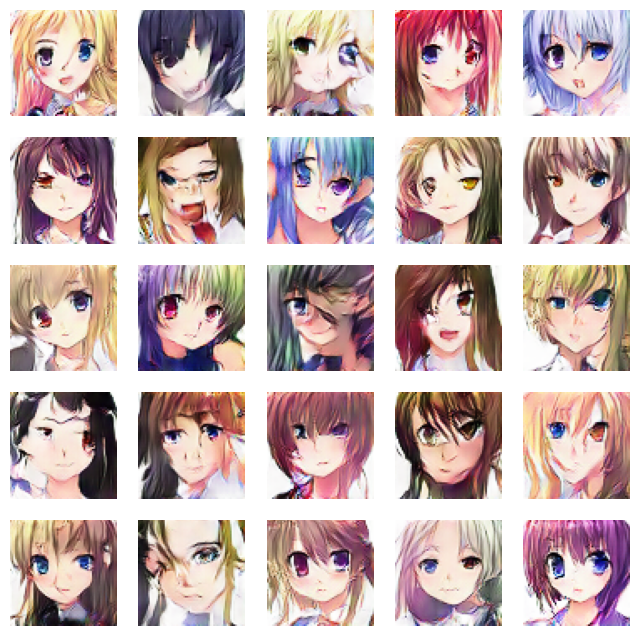

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6221 - g_loss: 1.0192
Epoch 45/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6204 - g_loss: 1.0354

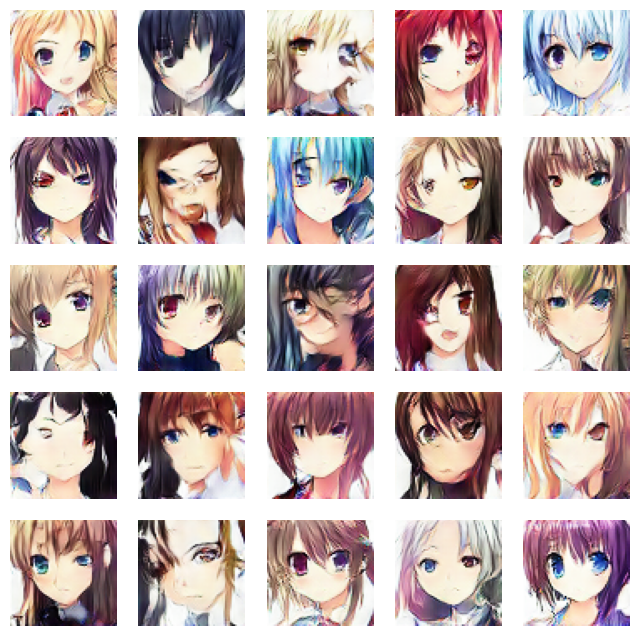

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6204 - g_loss: 1.0353
Epoch 46/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6173 - g_loss: 1.0438

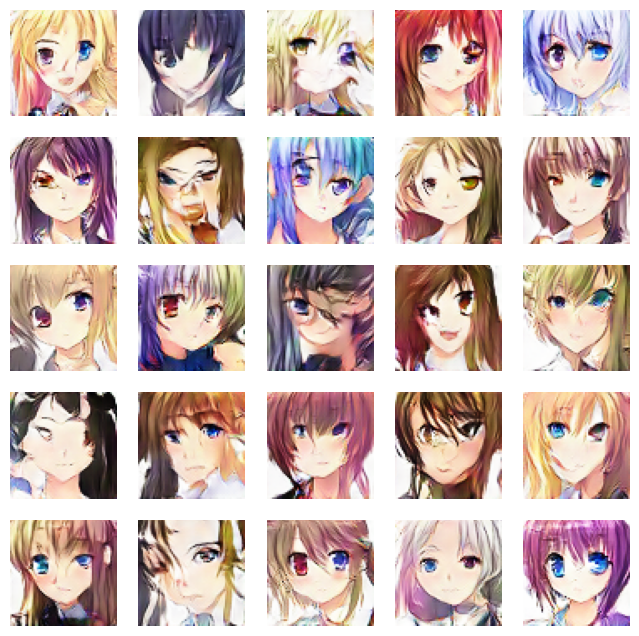

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6173 - g_loss: 1.0438
Epoch 47/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6108 - g_loss: 1.0558

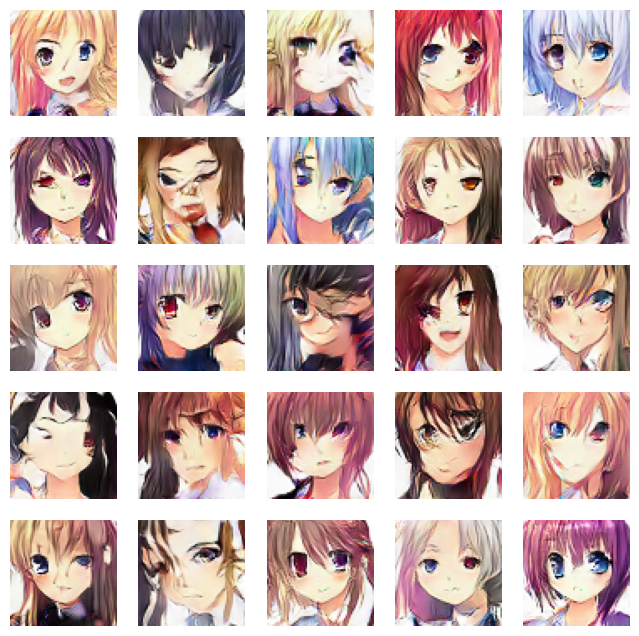

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6108 - g_loss: 1.0561
Epoch 48/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6056 - g_loss: 1.0806

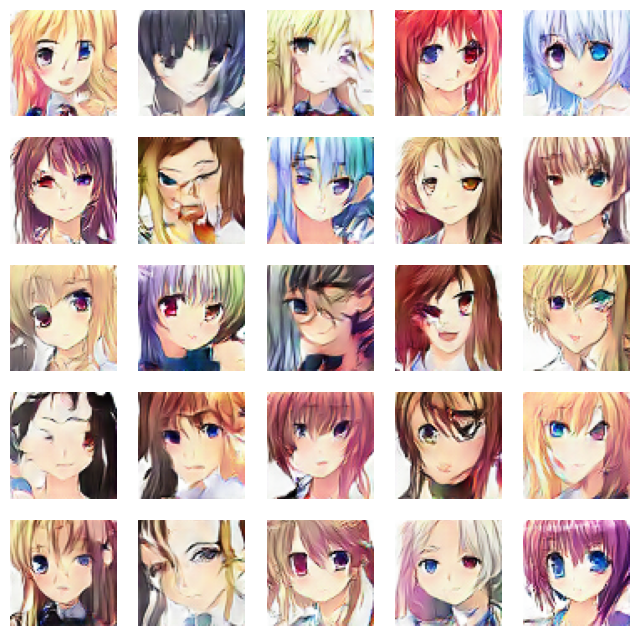

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6055 - g_loss: 1.0808
Epoch 49/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6028 - g_loss: 1.1031

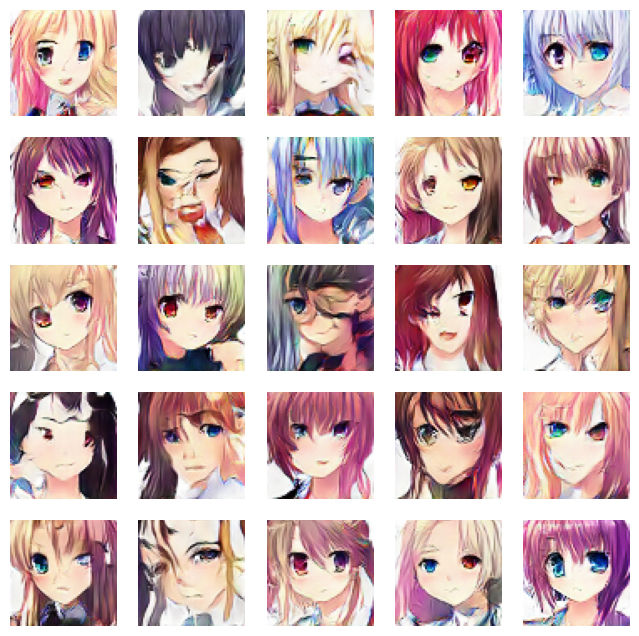

674/674 [==============================] - 49s 73ms/step - d_loss: 0.6027 - g_loss: 1.1035
Epoch 50/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5983 - g_loss: 1.1137

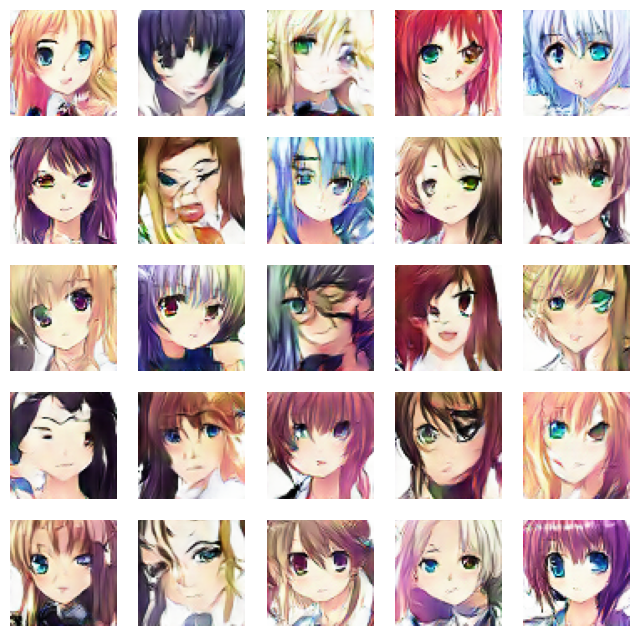

674/674 [==============================] - 49s 73ms/step - d_loss: 0.5983 - g_loss: 1.1136


In [19]:
N_EPOCHS = 50
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

Generate New Anime Image

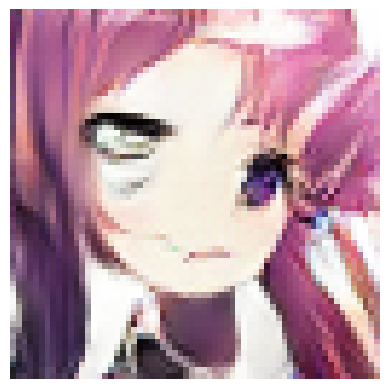

In [20]:
noise = tf.random.normal([1, 100])
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the amage
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow (img)
plt.axis('off')
# plt. savefiglepoch_ (:83d) .png', format (epoch))
plt.show()